In [1]:
import os

gpu_num = 0  # Use "" to use the CPU
os.environ["CUDA_VISIBLE_DEVICES"] = f"{gpu_num}"
os.environ["TF_CPP_MIN_LOG_LEVEL"] = "3"

# Colab does currently not support the latest version of ipython.
# Thus, the preview does not work in Colab. However, whenever possible we
# strongly recommend to use the scene preview mode.
try:  # detect if the notebook runs in Colab
    import google.colab

    colab_compat = True  # deactivate preview
except:
    colab_compat = False
resolution = [480, 320]  # increase for higher quality of renderings


# Allows to exit cell execution in Jupyter
class ExitCell(Exception):
    def _render_traceback_(self):
        pass

import mitsuba as mi
mi.set_variant("llvm_ad_rgb")

# Import Sionna
try:
    import sionna
except ImportError as e:
    # Install Sionna if package is not already installed
    import os

    os.system("pip install sionna")
    import sionna

# Configure the notebook to use only a single GPU and allocate only as much memory as needed
# For more details, see https://www.tensorflow.org/guide/gpu
import tensorflow as tf

gpus = tf.config.list_physical_devices("GPU")
if gpus:
    try:
        tf.config.experimental.set_memory_growth(gpus[0], True)
    except RuntimeError as e:
        print(e)
# Avoid warnings from TensorFlow
tf.get_logger().setLevel("ERROR")

tf.random.set_seed(
    1
)  # Set global random seed for reproducibility

In [16]:
# Import Sionna RT components
from sionna.rt import load_scene, Transmitter, Receiver, PlanarArray, Camera
from src.classes.BostonTwin import BostonTwin
from pathlib import Path
import numpy as np

In [3]:
dataset_dir = Path("bostontwin")
bostwin = BostonTwin(dataset_dir)

31 scenes imported.


In [4]:
scene_names = bostwin.get_scene_names()
# scene_names

In [5]:
sionna_scene, scene_antennas = bostwin.load_bostontwin("BOS_G_5")

In [27]:
[sionna_scene.remove(tx) for tx in sionna_scene.transmitters]
[sionna_scene.remove(rx) for rx in sionna_scene.receivers]
bostwin.add_scene_antennas(np.arange(scene_antennas.shape[0]),[])

[575.7968669906822, 670.6518801210732, 10]
[-729.0562068608451, 630.9799155125274, 10]
[-718.9019477823513, 747.6598178502481, 10]
[548.8934300230758, 745.8291868949709, 10]
[624.673576550993, 700.4410516053613, 10]
[157.62939901245954, 724.4629696802458, 10]
[-16.642377387281158, 658.7420801511053, 10]
[-120.24724080485794, 598.1449012304347, 10]
[-341.9289252311046, 520.8719999016757, 10]
[131.9292136831791, 756.7717840518708, 10]
[-152.8892694557453, 651.858990878678, 10]
[586.8767940079051, 646.1586662982863, 10]
[630.7089719273426, 546.9617188206012, 10]
[-98.86944033684631, 539.5998530572779, 10]
[670.227237712239, 420.7517520568417, 10]
[-175.77051100440985, 409.04347868149125, 10]
[421.93964687802327, 358.98448498417747, 10]
[306.45495273190863, 351.4174944668448, 10]
[568.9331010555034, 343.27212665734623, 10]
[733.3974897249627, 310.6549613920506, 10]
[-228.51495382819667, 275.05047598289093, 10]
[177.83850378626266, 249.149965259925, 10]
[457.9075586154959, 200.3212187818771

{'TX_0': <sionna.rt.transmitter.Transmitter at 0x7f3ea44f7f70>,
 'TX_1': <sionna.rt.transmitter.Transmitter at 0x7f3eef661190>,
 'TX_2': <sionna.rt.transmitter.Transmitter at 0x7f3eef661730>,
 'TX_3': <sionna.rt.transmitter.Transmitter at 0x7f3ea44f7d90>,
 'TX_4': <sionna.rt.transmitter.Transmitter at 0x7f3ea44f78e0>,
 'TX_5': <sionna.rt.transmitter.Transmitter at 0x7f3ea44f7ca0>,
 'TX_6': <sionna.rt.transmitter.Transmitter at 0x7f3db4858a00>,
 'TX_7': <sionna.rt.transmitter.Transmitter at 0x7f3db4705160>,
 'TX_8': <sionna.rt.transmitter.Transmitter at 0x7f3db47059d0>,
 'TX_9': <sionna.rt.transmitter.Transmitter at 0x7f3db507abb0>,
 'TX_10': <sionna.rt.transmitter.Transmitter at 0x7f3db45892b0>,
 'TX_11': <sionna.rt.transmitter.Transmitter at 0x7f3db4858550>,
 'TX_12': <sionna.rt.transmitter.Transmitter at 0x7f3db4858b50>,
 'TX_13': <sionna.rt.transmitter.Transmitter at 0x7f3db48587f0>,
 'TX_14': <sionna.rt.transmitter.Transmitter at 0x7f3db4858be0>,
 'TX_15': <sionna.rt.transmitter.Tr

In [28]:
# Configure antenna array for all transmitters
sionna_scene.tx_array = PlanarArray(num_rows=1, 
                             num_cols=1,
                             vertical_spacing=0.5,
                             horizontal_spacing=0.5,
                             pattern="tr38901",
                             polarization="V")

# Configure antenna array for all receivers
sionna_scene.rx_array = PlanarArray(num_rows=1,
                             num_cols=1,
                             vertical_spacing=0.5,
                             horizontal_spacing=0.5,
                             pattern="dipole",
                             polarization="cross")


In [29]:
sionna_scene.preview()

Renderer(camera=PerspectiveCamera(aspect=1.31, children=(DirectionalLight(intensity=0.25, matrixWorldNeedsUpda…

In [9]:
mi_scene = sionna_scene.mi_scene

<Axes: >

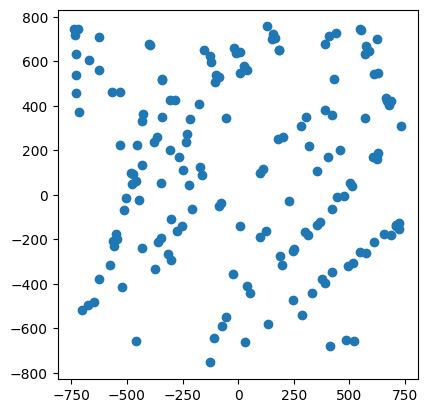

In [10]:
scene_antennas.plot()

In [ ]:
cm = sionna_scene.coverage_map(max_depth=2,
                        diffraction=True, # Disable to see the effects of diffraction
                        cm_cell_size=(5., 5.), # Grid size of coverage map cells in m
                        combining_vec=None,
                        precoding_vec=None,
                        num_samples=int(2e6))

In [12]:
sionna_scene.preview(coverage_map=cm)

Renderer(camera=PerspectiveCamera(aspect=1.31, children=(DirectionalLight(intensity=0.25, position=(0.0, 0.0, …

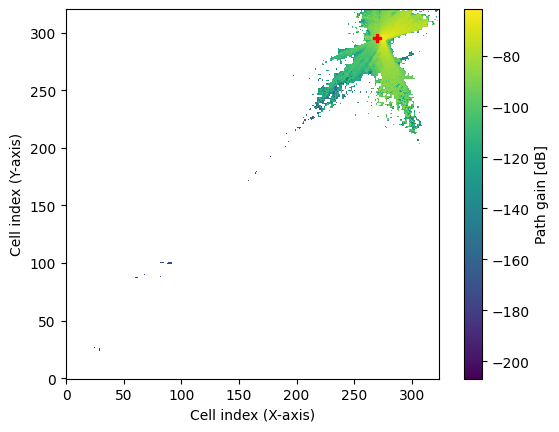

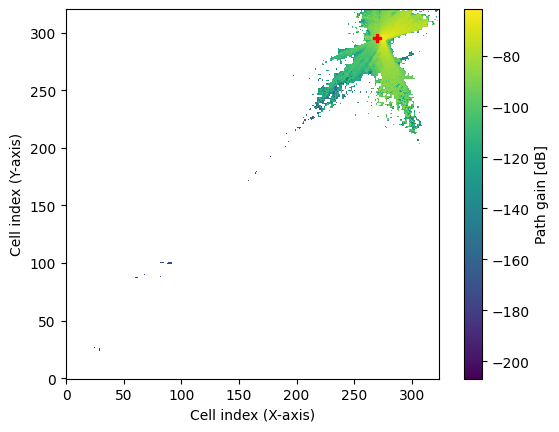

In [15]:
cm.show()

In [23]:
cms = np.array(cm.as_tensor())
cms_max = np.expand_dims(np.max(cms,axis=0),axis=0)
cms_max.shape

(1, 321, 324)

In [24]:
cm_max = sionna.rt.CoverageMap(center=cm.center,
                 orientation=cm.orientation,
                 size=cm.size,
                 cell_size=cm.cell_size,
                 value=cms_max,
                 scene=sionna_scene)

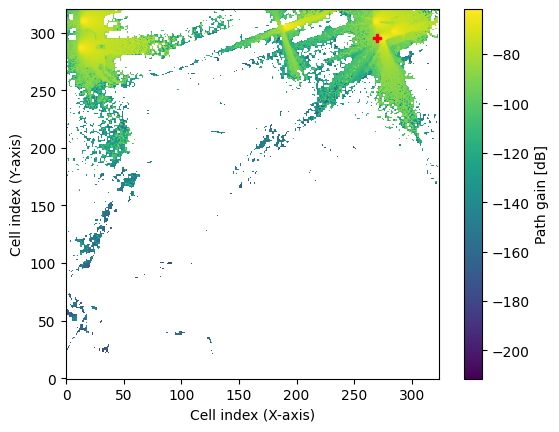

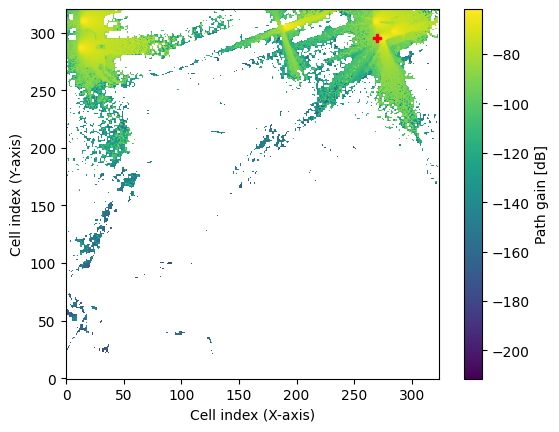

In [25]:
cm_max.show()